# **Adversarial-Training-Bracs**

In [2]:
!git clone https://github.com/hila-chefer/Transformer-Explainability.git

import os
os.chdir(f'./Transformer-Explainability')

Cloning into 'Transformer-Explainability'...
remote: Enumerating objects: 377, done.
remote: Total 377 (delta 0), reused 0 (delta 0), pack-reused 377
Receiving objects: 100% (377/377), 3.84 MiB | 9.14 MiB/s, done.
Resolving deltas: 100% (191/191), done.


In [3]:
!pip install einops
!pip install torchattacks

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 41 kB 510 kB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 155 kB 11.5 MB/s 


In [4]:
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import torch
import numpy as np
import cv2
import random
import tqdm
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as T
from torch.utils.data import DataLoader
from torchattacks.attacks.apgd import APGD 
from torchvision.utils import save_image
from PIL import Image
from IPython.display import display
from torchattacks import PGD
from torchvision.utils import save_image
from baselines.ViT.ViT_LRP import deit_base_patch16_224 as vit_LRP
#from baselines.ViT.ViT_LRP import vit_base_patch16_224 as vit_LRP
from baselines.ViT.ViT_explanation_generator import LRP
from baselines.ViT.ViT_LRP import VisionTransformer
from baselines.ViT.helpers import load_pretrained

In [5]:
#@title Imagenet class indices to names
%%capture
CLS2IDX = {0: '0_N',
 1: '1_PB',
 2: '2_UDH',
 3: '3_ADH',
 4: '4_FEA',
 5: '5_DCIS',
 6: '6_IC'}

In [6]:
def safe_divide(a, b):
    den = b.clamp(min=1e-9) + b.clamp(max=1e-9)
    den = den + den.eq(0).type(den.type()) * 1e-9
    return a / den * b.ne(0).type(b.type())
    
def forward_hook(self, input, output):
    if type(input[0]) in (list, tuple):
        self.X = []
        for i in input[0]:
            x = i.detach()
            x.requires_grad = True
            self.X.append(x)
    else:
        self.X = input[0].detach()
        self.X.requires_grad = True

    self.Y = output

class RelProp(nn.Module):
    def __init__(self):
        super(RelProp, self).__init__()
        # if not self.training:
        self.register_forward_hook(forward_hook)

    def gradprop(self, Z, X, S):
        C = torch.autograd.grad(Z, X, S, retain_graph=True)
        return C

    def relprop(self, R, alpha):
        return R

class IndexSelect(RelProp):
    def forward(self, inputs, dim, indices):
        self.__setattr__('dim', dim)
        self.__setattr__('indices', indices)

        return torch.index_select(inputs, dim, CLS2IDX)

    def relprop(self, R, alpha):
        Z = self.forward(self.X, self.dim, CLS2IDX)
        S = safe_divide(R, Z)
        C = self.gradprop(Z, self.X, S)

        if torch.is_tensor(self.X) == False:
            outputs = []
            outputs.append(self.X[0] * C[0])
            outputs.append(self.X[1] * C[1])
        else:
            outputs = self.X * (C[0])
        return outputs

In [ ]:
#Download dataset
!wget -c -r ftp://histoimage.na.icar.cnr.it/BRACS_RoI/previous_versions/Version1_MedIA/Images
#transform downloaded dataset to 224*224 and save it in google Drive
'''
code
'''

In [7]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#unzip saved images into current drive account (I had to use different accounts due to google colab's limitation. Actulally notebook sharing wasn't working neither :)) )
!unzip -u "/content/drive/MyDrive/Images-20221110T104340Z-001.zip" -d "/content/drive/My Drive/Bracs"

In [8]:
transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
])

In [9]:
def prepareDatasets(direction, share=1):
    cnt = 0
    dataset = list()

    for folder in os.listdir(direction):
        print(folder)

        if share != 1:
          randomlist = []
          for i in range(0,int ( share * len(os.listdir(direction + f'/{folder}')))):
            n = random.randint(1,len(os.listdir(direction + f'/{folder}')))
            randomlist.append(n)

        cnt = 0
        for image in os.listdir(direction + f'/{folder}'):

            if share != 1:
              if cnt not in randomlist:
                cnt += 1
                continue

            im= Image.open(os.path.join(direction + f'/{folder}',image))
            try:

              img = transform(im)

              label = torch.tensor(int(folder[0]))
              data = {"image": img, "label": label}
              dataset.append(data)
              cnt += 1
            except (OSError):
              print("shit")

    return dataset

train_dir = "/content/drive/MyDrive/Bracs/Images/Train"
val_dir = "/content/drive/MyDrive/Bracs/Images/Validation"

train_dataset = prepareDatasets(train_dir)
print(np.shape(train_dataset))
#For example, prepareDatasets(train_dir, share=0.3) picks 0.3 of images

validation_dataset = prepareDatasets(val_dir)
print(np.shape(validation_dataset))


1_PB
2_UDH
5_DCIS
3_ADH
0_N
6_IC
4_FEA
(3163,)
4_FEA
0_N
3_ADH
5_DCIS
1_PB
2_UDH
6_IC
(602,)


In [10]:
data = DataLoader(
    train_dataset,
    batch_size=20,
    shuffle=True,
    num_workers=2,
 )


data_val = DataLoader(
    validation_dataset,
    batch_size=20,
    shuffle=False,
    num_workers=2,
 )

In [11]:
model = vit_LRP(pretrained=True).cuda()

model.head.out_features = 7
#model.pool = IndexSelect()

Downloading: "https://dl.fbaipublicfiles.com/deit/deit_base_patch16_224-b5f2ef4d.pth" to /root/.cache/torch/hub/checkpoints/deit_base_patch16_224-b5f2ef4d.pth


  0%|          | 0.00/330M [00:00<?, ?B/s]

In [12]:
def _cfg(url='', **kwargs):
    return {
        'url': url,
        'num_classes': 7, 'input_size': (3, 224, 224), 'pool_size': None,
        'crop_pct': .9, 'interpolation': 'bicubic',
        'first_conv': 'patch_embed.proj', 'classifier': 'head',
        **kwargs
    }


default_cfgs = {
    # patch models
    'vit_small_patch16_224': _cfg(
        url='https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/vit_small_p16_224-15ec54c9.pth',
    ),
    'vit_base_patch16_224': _cfg(
        url='https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-vitjx/jx_vit_base_p16_224-80ecf9dd.pth',
        mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5),
    ),
    'vit_large_patch16_224': _cfg(
        url='https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-vitjx/jx_vit_large_p16_224-4ee7a4dc.pth',
        mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)),
}

def _conv_filter(state_dict, patch_size=16):
    """ convert patch embedding weight from manual patchify + linear proj to conv"""
    out_dict = {}
    for k, v in state_dict.items():
        if 'patch_embed.proj.weight' in k:
            v = v.reshape((v.shape[0], 3, patch_size, patch_size))
        out_dict[k] = v
    return out_dict

def vit_base_patch16_224_7class(pretrained=False, **kwargs):
    model = VisionTransformer(
        patch_size=16, num_classes=7, embed_dim=768, depth=12, num_heads=12, mlp_ratio=4, qkv_bias=True, **kwargs)
    model.default_cfg = default_cfgs['vit_base_patch16_224']
    if pretrained:
        load_pretrained(
            model, num_classes=model.num_classes, in_chans=kwargs.get('in_chans', 3), filter_fn=_conv_filter)
    return model

def vit_large_patch16_224_7class(pretrained=False, **kwargs):
    model = VisionTransformer(
        patch_size=16, num_classes=7, embed_dim=1024, depth=24, num_heads=16, mlp_ratio=4, qkv_bias=True, **kwargs)
    model.default_cfg = default_cfgs['vit_large_patch16_224']
    if pretrained:
        load_pretrained(model, num_classes=model.num_classes, in_chans=kwargs.get('in_chans', 3))
    return model

def deit_base_patch16_224_7class(pretrained=False, **kwargs):
    model = VisionTransformer(
        patch_size=16, num_classes=7, embed_dim=768, depth=12, num_heads=12, mlp_ratio=4, qkv_bias=True, **kwargs)
    model.default_cfg = _cfg()
    if pretrained:
        checkpoint = torch.hub.load_state_dict_from_url(
            url="https://dl.fbaipublicfiles.com/deit/deit_base_patch16_224-b5f2ef4d.pth",
            map_location="cpu", check_hash=True
        )
        model.load_state_dict(checkpoint["model"])
    return model

In [13]:
#model = deit_base_patch16_224_7class(pretrained=False).cuda()
#model = vit_base_patch16_224_7class(pretrained=False).cuda()
#model = torch.load('/content/drive/MyDrive/Models_saves/model5.pth')
model.load_state_dict(torch.load('/content/drive/MyDrive/Models_saves/model_state_dict10.pth'))

<All keys matched successfully>

In [14]:
model

VisionTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
  )
  (blocks): ModuleList(
    (0): Block(
      (norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
      (attn): Attention(
        (matmul1): einsum()
        (matmul2): einsum()
        (qkv): Linear(in_features=768, out_features=2304, bias=True)
        (attn_drop): Dropout(p=0.0, inplace=False)
        (proj): Linear(in_features=768, out_features=768, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
        (softmax): Softmax(dim=-1)
      )
      (norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
      (mlp): Mlp(
        (fc1): Linear(in_features=768, out_features=3072, bias=True)
        (act): GELU(approximate='none')
        (fc2): Linear(in_features=3072, out_features=768, bias=True)
        (drop): Dropout(p=0.0, inplace=False)
      )
      (add1): Add()
      (add2): Add()
      (clone1): Clone()
      (clone2): Clone()
  

In [15]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(device)

attack = APGD(model, eps=(42/255), norm='L2', steps = 10)

print(attack.eps)

cuda
0.16470588235294117


In [ ]:
#This cell is for saving noises and is unnecessary 
with tqdm.tqdm(enumerate(data), total=len(data)) as pbar:
    ad_images = torch.Tensor(list())
    cnt = 0
    for i, x in pbar:
      
      cnt+=1
      image = x["image"]
      label = x["label"]
      image = image.to(device)
      label = label.to(device)

      ad_images = attack(image, label)

      result = torch.cat((image, ad_images))
      result = torch.cat((result, ad_images - image))
      save_image(result, fp = f'/content/out{cnt}.png' ,nrow = len(label), scale_each=True, normalize=True)


 77%|███████▋  | 122/159 [01:43<00:31,  1.18it/s]


KeyboardInterrupt: ignored

In [16]:
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(model.parameters(), lr=4e-3, momentum=0.8)

In [17]:
def train_val(mode, adv, losses, epoch):

    #torch.cuda.empty_cache()
    loss_sum = 0
    true = 0
    all = 0
    class0_true = 0
    class0_all = 0
    class1_true = 0
    class1_all = 0
    class2_true = 0
    class2_all = 0
    class3_true = 0
    class3_all = 0
    class4_true = 0
    class4_all = 0
    class5_true =  0
    class5_all = 0
    class6_true = 0
    class6_all = 0

    i = 0
    if mode == 'train':
      img_data = data
    elif mode == 'val':
      img_data = data_val
    else:
      img_data = data_test

    with tqdm.tqdm(enumerate(img_data), total=len(img_data)) as pbar:
        ad_images = torch.Tensor(list())

        for i, x in pbar:
            
            image = x["image"]
            label = x["label"]
            image = image.to(device)
            label = label.to(device)

            model.eval()

            if adv and ((mode == 'val') or (mode == 'train' and epoch > 1)):
              ad_images = attack(image, label)
            
            if mode == 'train':
              model.train()

            if adv and ((mode == 'val') or (mode == 'train' and epoch > 1)):
              p = model(ad_images)
            else:
              p = model(image)

            loss = criterion(p[:, :7], label)
            loss_sum += float(loss)*20

            predictions = p[:, :7].argmax(-1)
            all += float(len(predictions))
            class0_all += float((label == 0).sum())
            class1_all += float((label == 1).sum())
            class2_all += float((label == 2).sum())
            class3_all += float((label == 3).sum())
            class4_all += float((label == 4).sum())
            class5_all += float((label == 5).sum())
            class6_all += float((label == 6).sum())
            true += float((predictions == label).sum())

            class0_pred = (predictions == 0)
            class0_label = (label == 0)
            class0_true += float((torch.logical_and(class0_pred,class0_label)).sum())

            class1_pred = (predictions == 1)
            class1_label = (label == 1)
            class1_true += float((torch.logical_and(class1_pred,class1_label)).sum())

            class2_pred = (predictions == 2)
            class2_label = (label == 2)
            class2_true += float((torch.logical_and(class2_pred,class2_label)).sum())

            class3_pred = (predictions == 3)
            class3_label = (label == 3)
            class3_true += float((torch.logical_and(class3_pred,class3_label)).sum())


            class4_pred = (predictions == 4)
            class4_label = (label == 4)
            class4_true += float((torch.logical_and(class4_pred,class4_label)).sum())

            class5_pred = (predictions == 5)
            class5_label = (label == 5)
            class5_true += float((torch.logical_and(class5_pred,class5_label)).sum())


            class6_pred = (predictions == 6)
            class6_label = (label == 6)
            class6_true += float((torch.logical_and(class6_pred,class6_label)).sum())

            del image
            del label

            pbar.set_description(f'Acc: {true * 100. / all:.2f}%')
            
            if mode == 'train':
              loss.backward()
              optimizer.step()
              optimizer.zero_grad()

        if (class0_all > 0): print(f'Acc class0: {class0_true * 100. / class0_all:.2f}%')
        if (class1_all > 0): print(f'Acc class1: {class1_true * 100. / class1_all:.2f}%')
        if (class2_all > 0): print(f'Acc class2: {class2_true * 100. / class2_all:.2f}%')
        if (class3_all > 0): print(f'Acc class3: {class3_true * 100. / class3_all:.2f}%')
        if (class4_all > 0): print(f'Acc class4: {class4_true * 100. / class4_all:.2f}%')
        if (class5_all > 0): print(f'Acc class5: {class5_true * 100. / class5_all:.2f}%')
        if (class6_all > 0): print(f'Acc class6: {class6_true * 100. / class6_all:.2f}%')

    losses.append(loss_sum)
    if mode == 'train':
      torch.save(model.state_dict(), f'/content/drive/MyDrive/Models_saves/model_state_dict{epoch}.pth')
    
    state = 'train' if mode == 'train' else ('adversarial validation' if adv else 'validation')
    print(f'{state} : Epoch {epoch} \n')

    return losses

In [ ]:
num_epochs=15
train_losses = []
val_losses = []
adv_val_losses = []

for epoch in range(num_epochs):
    train_losses = train_val('train', True, train_losses, epoch)
    val_losses = train_val('val', False, val_losses, epoch)
    adv_val_losses = train_val('val', True, adv_val_losses, epoch)

Acc: 64.69%: 100%|██████████| 159/159 [01:49<00:00,  1.46it/s]


Acc class0: 55.56%
Acc class1: 64.33%
Acc class2: 19.80%
Acc class3: 40.49%
Acc class4: 83.31%
Acc class5: 81.14%
Acc class6: 81.97%
train : Epoch 0 



Acc: 54.15%: 100%|██████████| 31/31 [00:07<00:00,  4.05it/s]

Acc class0: 37.21%
Acc class1: 34.48%
Acc class2: 75.00%
Acc class3: 19.48%
Acc class4: 44.71%
Acc class5: 67.01%
Acc class6: 97.56%
validation : Epoch 0 




Acc: 54.15%: 100%|██████████| 31/31 [00:22<00:00,  1.35it/s]

Acc class0: 37.21%
Acc class1: 34.48%
Acc class2: 75.00%
Acc class3: 19.48%
Acc class4: 44.71%
Acc class5: 67.01%
Acc class6: 97.56%
adversarial validation : Epoch 0 




Acc: 80.08%: 100%|██████████| 159/159 [01:46<00:00,  1.50it/s]


Acc class0: 77.19%
Acc class1: 76.45%
Acc class2: 51.82%
Acc class3: 61.23%
Acc class4: 92.49%
Acc class5: 90.21%
Acc class6: 96.99%
train : Epoch 1 



Acc: 60.30%: 100%|██████████| 31/31 [00:07<00:00,  4.08it/s]

Acc class0: 79.07%
Acc class1: 48.28%
Acc class2: 55.68%
Acc class3: 27.27%
Acc class4: 65.88%
Acc class5: 63.92%
Acc class6: 79.27%
validation : Epoch 1 




Acc: 59.97%: 100%|██████████| 31/31 [00:39<00:00,  1.26s/it]

Acc class0: 79.07%
Acc class1: 48.28%
Acc class2: 55.68%
Acc class3: 27.27%
Acc class4: 65.88%
Acc class5: 61.86%
Acc class6: 79.27%
adversarial validation : Epoch 1 




Acc: 86.15%: 100%|██████████| 159/159 [09:48<00:00,  3.70s/it]


Acc class0: 88.30%
Acc class1: 85.67%
Acc class2: 65.02%
Acc class3: 71.36%
Acc class4: 93.66%
Acc class5: 92.17%
Acc class6: 97.27%
train : Epoch 2 



Acc: 59.14%: 100%|██████████| 31/31 [00:07<00:00,  4.11it/s]

Acc class0: 56.98%
Acc class1: 58.62%
Acc class2: 52.27%
Acc class3: 18.18%
Acc class4: 48.24%
Acc class5: 85.57%
Acc class6: 87.80%
validation : Epoch 2 




Acc: 57.97%: 100%|██████████| 31/31 [01:04<00:00,  2.07s/it]

Acc class0: 56.98%
Acc class1: 58.62%
Acc class2: 52.27%
Acc class3: 15.58%
Acc class4: 45.88%
Acc class5: 82.47%
Acc class6: 87.80%
adversarial validation : Epoch 2 




Acc: 92.41%: 100%|██████████| 159/159 [13:07<00:00,  4.95s/it]


Acc class0: 91.81%
Acc class1: 92.83%
Acc class2: 80.86%
Acc class3: 84.69%
Acc class4: 95.66%
Acc class5: 96.09%
Acc class6: 99.45%
train : Epoch 3 



Acc: 59.80%: 100%|██████████| 31/31 [00:07<00:00,  4.11it/s]

Acc class0: 66.28%
Acc class1: 43.68%
Acc class2: 47.73%
Acc class3: 19.48%
Acc class4: 62.35%
Acc class5: 87.63%
Acc class6: 85.37%
validation : Epoch 3 




Acc: 57.81%: 100%|██████████| 31/31 [01:26<00:00,  2.78s/it]

Acc class0: 66.28%
Acc class1: 42.53%
Acc class2: 43.18%
Acc class3: 15.58%
Acc class4: 62.35%
Acc class5: 83.51%
Acc class6: 85.37%
adversarial validation : Epoch 3 




Acc: 94.91%: 100%|██████████| 159/159 [15:15<00:00,  5.76s/it]


Acc class0: 94.74%
Acc class1: 93.86%
Acc class2: 87.46%
Acc class3: 89.88%
Acc class4: 97.50%
Acc class5: 98.22%
Acc class6: 99.18%
train : Epoch 4 



Acc: 60.63%: 100%|██████████| 31/31 [00:07<00:00,  4.10it/s]

Acc class0: 77.91%
Acc class1: 36.78%
Acc class2: 70.45%
Acc class3: 19.48%
Acc class4: 65.88%
Acc class5: 65.98%
Acc class6: 84.15%
validation : Epoch 4 




Acc: 57.97%: 100%|██████████| 31/31 [01:26<00:00,  2.78s/it]

Acc class0: 76.74%
Acc class1: 33.33%
Acc class2: 68.18%
Acc class3: 19.48%
Acc class4: 63.53%
Acc class5: 59.79%
Acc class6: 81.71%
adversarial validation : Epoch 4 




Acc: 95.95%: 100%|██████████| 159/159 [17:12<00:00,  6.49s/it]


Acc class0: 96.20%
Acc class1: 95.90%
Acc class2: 92.08%
Acc class3: 91.36%
Acc class4: 96.99%
Acc class5: 97.51%
Acc class6: 100.00%
train : Epoch 5 



Acc: 64.62%: 100%|██████████| 31/31 [00:07<00:00,  4.03it/s]

Acc class0: 83.72%
Acc class1: 47.13%
Acc class2: 56.82%
Acc class3: 31.17%
Acc class4: 64.71%
Acc class5: 75.26%
Acc class6: 90.24%
validation : Epoch 5 




Acc: 60.80%: 100%|██████████| 31/31 [01:42<00:00,  3.31s/it]

Acc class0: 81.40%
Acc class1: 39.08%
Acc class2: 55.68%
Acc class3: 23.38%
Acc class4: 62.35%
Acc class5: 71.13%
Acc class6: 89.02%
adversarial validation : Epoch 5 




Acc: 98.93%: 100%|██████████| 159/159 [19:14<00:00,  7.26s/it]


Acc class0: 97.95%
Acc class1: 97.95%
Acc class2: 99.01%
Acc class3: 98.02%
Acc class4: 99.83%
Acc class5: 99.47%
Acc class6: 100.00%
train : Epoch 6 



Acc: 64.29%: 100%|██████████| 31/31 [00:07<00:00,  4.09it/s]

Acc class0: 76.74%
Acc class1: 55.17%
Acc class2: 55.68%
Acc class3: 33.77%
Acc class4: 67.06%
Acc class5: 72.16%
Acc class6: 86.59%
validation : Epoch 6 




Acc: 60.13%: 100%|██████████| 31/31 [01:53<00:00,  3.67s/it]

Acc class0: 74.42%
Acc class1: 50.57%
Acc class2: 50.00%
Acc class3: 25.97%
Acc class4: 63.53%
Acc class5: 67.01%
Acc class6: 86.59%
adversarial validation : Epoch 6 




Acc: 98.93%: 100%|██████████| 159/159 [19:59<00:00,  7.54s/it]


Acc class0: 97.37%
Acc class1: 98.12%
Acc class2: 99.01%
Acc class3: 99.26%
Acc class4: 99.83%
Acc class5: 99.11%
Acc class6: 99.45%
train : Epoch 7 



Acc: 63.79%: 100%|██████████| 31/31 [00:07<00:00,  4.09it/s]

Acc class0: 79.07%
Acc class1: 43.68%
Acc class2: 62.50%
Acc class3: 33.77%
Acc class4: 61.18%
Acc class5: 77.32%
Acc class6: 85.37%
validation : Epoch 7 




Acc: 58.14%: 100%|██████████| 31/31 [01:59<00:00,  3.86s/it]

Acc class0: 75.58%
Acc class1: 37.93%
Acc class2: 57.95%
Acc class3: 23.38%
Acc class4: 55.29%
Acc class5: 71.13%
Acc class6: 81.71%
adversarial validation : Epoch 7 




Acc: 99.30%: 100%|██████████| 159/159 [20:03<00:00,  7.57s/it]


Acc class0: 99.42%
Acc class1: 98.98%
Acc class2: 98.68%
Acc class3: 98.52%
Acc class4: 99.83%
Acc class5: 99.64%
Acc class6: 99.73%
train : Epoch 8 



Acc: 64.62%: 100%|██████████| 31/31 [00:07<00:00,  4.08it/s]

Acc class0: 70.93%
Acc class1: 70.11%
Acc class2: 56.82%
Acc class3: 31.17%
Acc class4: 63.53%
Acc class5: 68.04%
Acc class6: 89.02%
validation : Epoch 8 




Acc: 60.30%: 100%|██████████| 31/31 [01:57<00:00,  3.80s/it]

Acc class0: 66.28%
Acc class1: 65.52%
Acc class2: 50.00%
Acc class3: 23.38%
Acc class4: 58.82%
Acc class5: 65.98%
Acc class6: 89.02%
adversarial validation : Epoch 8 




Acc: 99.65%: 100%|██████████| 159/159 [20:32<00:00,  7.75s/it]


Acc class0: 99.71%
Acc class1: 100.00%
Acc class2: 99.67%
Acc class3: 98.77%
Acc class4: 99.83%
Acc class5: 99.47%
Acc class6: 100.00%
train : Epoch 9 



Acc: 64.45%: 100%|██████████| 31/31 [00:07<00:00,  4.07it/s]

Acc class0: 70.93%
Acc class1: 66.67%
Acc class2: 43.18%
Acc class3: 29.87%
Acc class4: 75.29%
Acc class5: 76.29%
Acc class6: 85.37%
validation : Epoch 9 




Acc: 60.47%: 100%|██████████| 31/31 [02:05<00:00,  4.06s/it]

Acc class0: 68.60%
Acc class1: 62.07%
Acc class2: 37.50%
Acc class3: 24.68%
Acc class4: 72.94%
Acc class5: 69.07%
Acc class6: 85.37%
adversarial validation : Epoch 9 




Acc: 99.37%: 100%|██████████| 159/159 [20:43<00:00,  7.82s/it]


Acc class0: 100.00%
Acc class1: 99.66%
Acc class2: 99.01%
Acc class3: 98.02%
Acc class4: 99.83%
Acc class5: 99.29%
Acc class6: 99.45%
train : Epoch 10 



Acc: 63.46%: 100%|██████████| 31/31 [00:07<00:00,  4.04it/s]

Acc class0: 68.60%
Acc class1: 62.07%
Acc class2: 42.05%
Acc class3: 20.78%
Acc class4: 69.41%
Acc class5: 90.72%
Acc class6: 84.15%
validation : Epoch 10 




Acc: 59.97%: 100%|██████████| 31/31 [02:07<00:00,  4.11s/it]

Acc class0: 66.28%
Acc class1: 59.77%
Acc class2: 40.91%
Acc class3: 14.29%
Acc class4: 65.88%
Acc class5: 84.54%
Acc class6: 81.71%
adversarial validation : Epoch 10 




Acc: 99.94%: 100%|██████████| 159/159 [20:56<00:00,  7.90s/it]


Acc class0: 100.00%
Acc class1: 100.00%
Acc class2: 99.67%
Acc class3: 100.00%
Acc class4: 100.00%
Acc class5: 99.82%
Acc class6: 100.00%
train : Epoch 11 



Acc: 65.12%: 100%|██████████| 31/31 [00:07<00:00,  4.07it/s]

Acc class0: 69.77%
Acc class1: 64.37%
Acc class2: 47.73%
Acc class3: 33.77%
Acc class4: 74.12%
Acc class5: 76.29%
Acc class6: 86.59%
validation : Epoch 11 




Acc: 59.30%: 100%|██████████| 31/31 [02:12<00:00,  4.28s/it]

Acc class0: 65.12%
Acc class1: 57.47%
Acc class2: 38.64%
Acc class3: 27.27%
Acc class4: 67.06%
Acc class5: 72.16%
Acc class6: 84.15%
adversarial validation : Epoch 11 




Acc: 100.00%: 100%|██████████| 159/159 [21:04<00:00,  7.95s/it]


Acc class0: 100.00%
Acc class1: 100.00%
Acc class2: 100.00%
Acc class3: 100.00%
Acc class4: 100.00%
Acc class5: 100.00%
Acc class6: 100.00%
train : Epoch 12 



Acc: 65.12%: 100%|██████████| 31/31 [00:07<00:00,  4.07it/s]

Acc class0: 69.77%
Acc class1: 64.37%
Acc class2: 48.86%
Acc class3: 32.47%
Acc class4: 74.12%
Acc class5: 76.29%
Acc class6: 86.59%
validation : Epoch 12 




Acc: 58.80%: 100%|██████████| 31/31 [02:14<00:00,  4.35s/it]

Acc class0: 63.95%
Acc class1: 57.47%
Acc class2: 42.05%
Acc class3: 24.68%
Acc class4: 67.06%
Acc class5: 70.10%
Acc class6: 82.93%
adversarial validation : Epoch 12 




Acc: 100.00%: 100%|██████████| 159/159 [21:11<00:00,  7.99s/it]


Acc class0: 100.00%
Acc class1: 100.00%
Acc class2: 100.00%
Acc class3: 100.00%
Acc class4: 100.00%
Acc class5: 100.00%
Acc class6: 100.00%
train : Epoch 13 



Acc: 65.45%: 100%|██████████| 31/31 [00:07<00:00,  4.08it/s]

Acc class0: 69.77%
Acc class1: 64.37%
Acc class2: 50.00%
Acc class3: 32.47%
Acc class4: 75.29%
Acc class5: 76.29%
Acc class6: 86.59%
validation : Epoch 13 




Acc: 58.47%: 100%|██████████| 31/31 [02:16<00:00,  4.40s/it]

Acc class0: 62.79%
Acc class1: 55.17%
Acc class2: 44.32%
Acc class3: 23.38%
Acc class4: 68.24%
Acc class5: 69.07%
Acc class6: 82.93%
adversarial validation : Epoch 13 




Acc: 100.00%: 100%|██████████| 159/159 [21:01<00:00,  7.93s/it]


Acc class0: 100.00%
Acc class1: 100.00%
Acc class2: 100.00%
Acc class3: 100.00%
Acc class4: 100.00%
Acc class5: 100.00%
Acc class6: 100.00%
train : Epoch 14 



Acc: 65.45%: 100%|██████████| 31/31 [00:07<00:00,  3.99it/s]

Acc class0: 69.77%
Acc class1: 64.37%
Acc class2: 50.00%
Acc class3: 32.47%
Acc class4: 75.29%
Acc class5: 76.29%
Acc class6: 86.59%
validation : Epoch 14 




Acc: 58.80%: 100%|██████████| 31/31 [02:18<00:00,  4.47s/it]

Acc class0: 62.79%
Acc class1: 56.32%
Acc class2: 44.32%
Acc class3: 24.68%
Acc class4: 67.06%
Acc class5: 69.07%
Acc class6: 84.15%
adversarial validation : Epoch 14 



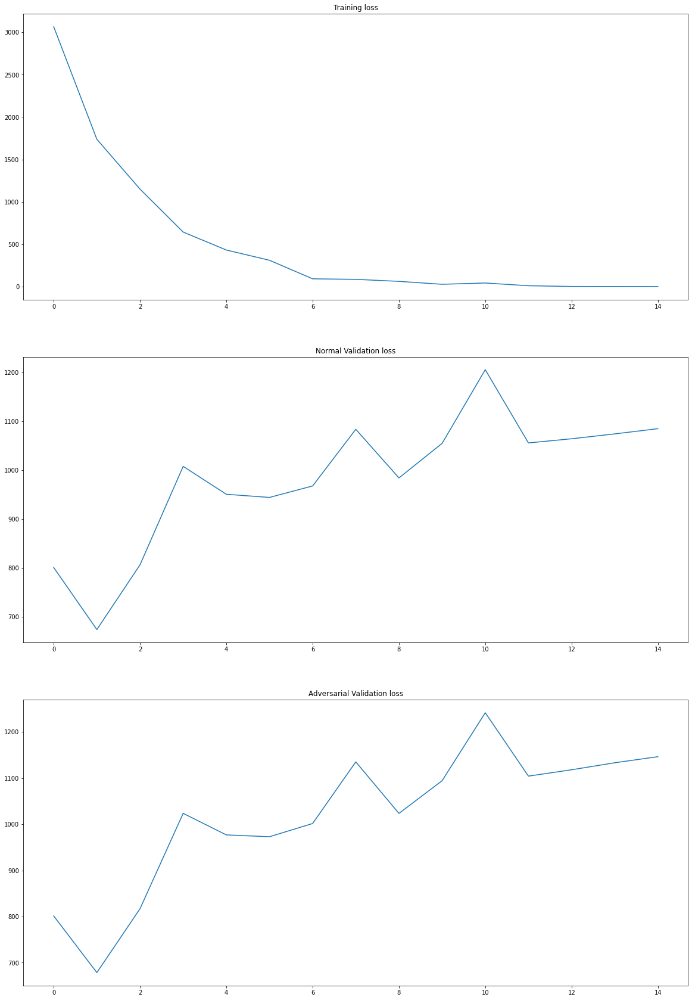

In [ ]:
#Plotting losses 
epochs = np.arange(15)

fig, (ax1, ax2, ax3) = plt.subplots(3, figsize=(20, 30))
ax1.set_title("Training loss")
ax1.plot(epochs, train_losses)

ax2.set_title("Normal Validation loss")
ax2.plot(epochs, val_losses)

ax3.set_title("Adversarial Validation loss")
ax3.plot(epochs, adv_val_losses)

In [ ]:
model.load_state_dict(torch.load('/content/drive/MyDrive/Models_saves/model_state_dict5.pth'))
#torch.save(model.state_dict(), '/content/drive/MyDrive/Models_saves/model_state_dict2.pth')

<All keys matched successfully>

In [ ]:
# create heatmap from mask on image
def show_cam_on_image(img, mask):
    heatmap = cv2.applyColorMap(np.uint8(255 * mask), cv2.COLORMAP_JET)
    heatmap = np.float32(heatmap) / 255
    cam = heatmap + np.float32(img)
    cam = cam / np.max(cam)
    return cam

attribution_generator = LRP(model)

def generate_visualization(original_image, class_index=None):
    transformer_attribution = attribution_generator.generate_LRP(original_image.unsqueeze(0).cuda(), method="transformer_attribution", index=class_index).detach()
    transformer_attribution = transformer_attribution.reshape(1, 1, 14, 14)
    transformer_attribution = torch.nn.functional.interpolate(transformer_attribution, scale_factor=16, mode='bilinear')
    transformer_attribution = transformer_attribution.reshape(224, 224).cuda().data.cpu().numpy()
    transformer_attribution = (transformer_attribution - transformer_attribution.min()) / (transformer_attribution.max() - transformer_attribution.min())
    image_transformer_attribution = original_image.permute(1, 2, 0).data.cpu().numpy()
    image_transformer_attribution = (image_transformer_attribution - image_transformer_attribution.min()) / (image_transformer_attribution.max() - image_transformer_attribution.min())
    vis = show_cam_on_image(image_transformer_attribution, transformer_attribution)
    vis =  np.uint8(255 * vis)
    vis = cv2.cvtColor(np.array(vis), cv2.COLOR_RGB2BGR)
    return vis

def print_top_classes(predictions, **kwargs):    
    # Print Top-5 predictions
    prob = torch.softmax(predictions, dim=1)
    class_indices = predictions.data.topk(5, dim=1)[1][0].tolist()
    max_str_len = 0
    class_names = []
    for cls_idx in class_indices:
        class_names.append(CLS2IDX[cls_idx])
        if len(CLS2IDX[cls_idx]) > max_str_len:
            max_str_len = len(CLS2IDX[cls_idx])
    
    print('Top 5 classes:')
    for cls_idx in class_indices:
        output_string = '\t{} : {}'.format(cls_idx, CLS2IDX[cls_idx])
        output_string += ' ' * (max_str_len - len(CLS2IDX[cls_idx])) + '\t\t'
        output_string += 'value = {:.3f}\t prob = {:.1f}%'.format(predictions[0, cls_idx], 100 * prob[0, cls_idx])
        print(output_string)

In [ ]:
def drawHeatmap(direction, index):
        
    for image in os.listdir(direction):

        image= Image.open(os.path.join(direction,image))

        transformed_image = transform(image)

        fig, axs = plt.subplots(1, 3)
        axs[0].imshow(image)
        axs[0].axis('off')

        output = model(transformed_image.unsqueeze(0).cuda())

        # generate visualization for the predicted class
        predicted = generate_visualization(transformed_image)

        # generate visualization for expected(index) class
        expected = generate_visualization(transformed_image, class_index=index)

        axs[1].imshow(predicted)
        axs[1].axis('off')
        axs[2].imshow(expected)
        axs[2].axis('off')

In [ ]:
val_dir0 = "/content/drive/MyDrive/Bracs/Images/Validation/0_N"
val_dir1 = "/content/drive/MyDrive/Bracs/Images/Validation/1_PB"
val_dir2 = "/content/drive/MyDrive/Bracs/Images/Validation/2_UDH"
val_dir3 = "/content/drive/MyDrive/Bracs/Images/Validation/3_ADH"
val_dir4 = "/content/drive/MyDrive/Bracs/Images/Validation/4_FEA"
val_dir5 = "/content/drive/MyDrive/Bracs/Images/Validation/5_DCIS"
val_dir6 = "/content/drive/MyDrive/Bracs/Images/Validation/6_IC"

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


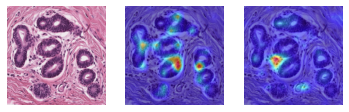

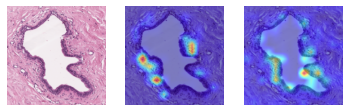

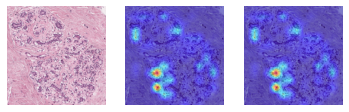

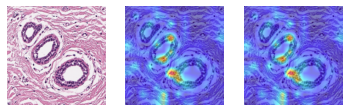

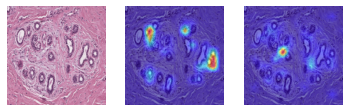

...

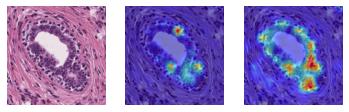

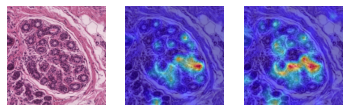

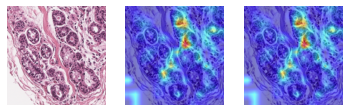

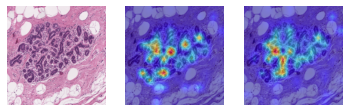

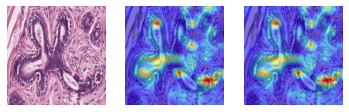

In [ ]:
drawHeatmap(val_dir0, 0)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


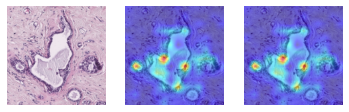

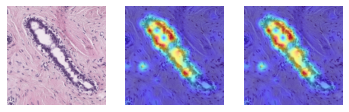

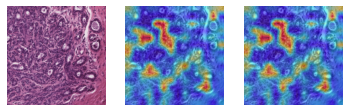

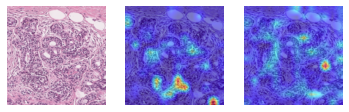

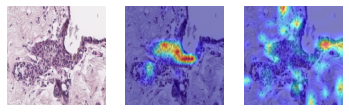

...

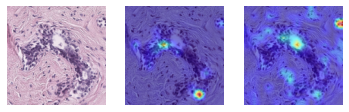

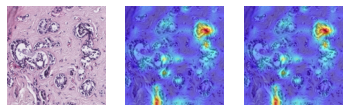

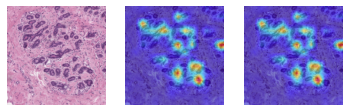

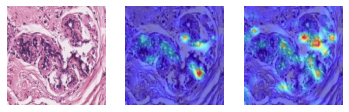

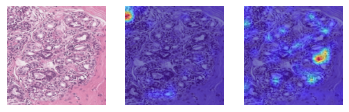

In [ ]:
drawHeatmap(val_dir1, 1)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


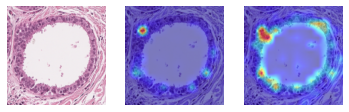

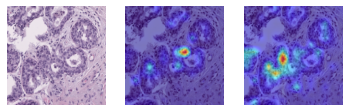

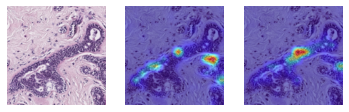

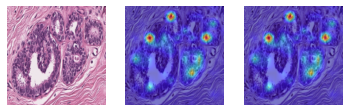

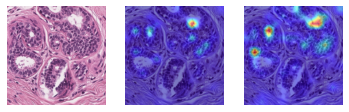

...

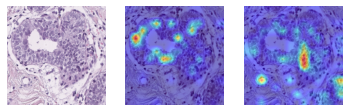

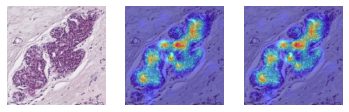

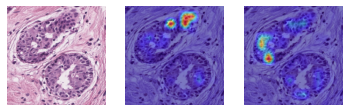

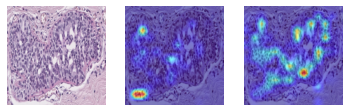

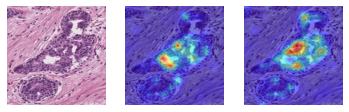

In [ ]:
drawHeatmap(val_dir2, 2)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


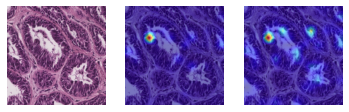

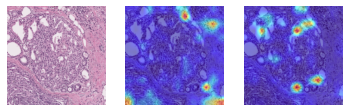

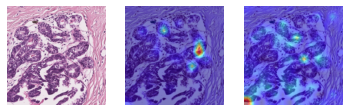

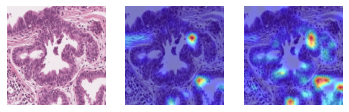

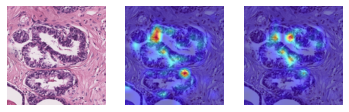

...

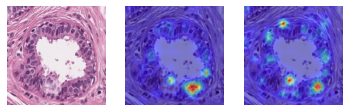

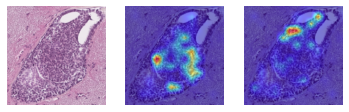

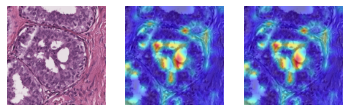

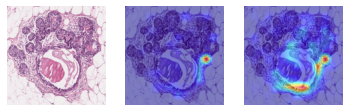

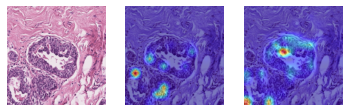

In [ ]:
drawHeatmap(val_dir3, 3)

In [ ]:
drawHeatmap(val_dir4, 4)

In [ ]:
drawHeatmap(val_dir5, 5)

In [ ]:
drawHeatmap(val_dir6, 6)

In [17]:
test_dir = "/content/drive/MyDrive/Bracs/Images/Test"

test_dataset = prepareDatasets(test_dir)
print(np.shape(test_dir))

0_N
3_ADH
1_PB
2_UDH
4_FEA
6_IC
5_DCIS
()


In [18]:
data_test = DataLoader(
    test_dataset,
    batch_size=20,
    shuffle=False,
    num_workers=2,
 )

In [21]:
val_losses = []
val_losses = train_val('val', False, val_losses, 1)

Acc: 62.96%: 100%|██████████| 31/31 [00:13<00:00,  2.34it/s]

Acc class0: 75.58%
Acc class1: 56.32%
Acc class2: 37.50%
Acc class3: 32.47%
Acc class4: 72.94%
Acc class5: 75.26%
Acc class6: 87.80%
validation : Epoch 1 



In [18]:
os.chdir(f'../drive/MyDrive')

#!git clone https://github.com/agup/soundness_saliency.git

import os
os.chdir(f'./soundness_saliency')

In [18]:
!python3 save_noise_batch.py

Traceback (most recent call last):
  File "save_noise_batch.py", line 53, in <module>
    imagenet_data = torchvision.datasets.ImageNet(IMAGENET_DIR,  split='train', transform = transform_train)
  File "/usr/local/lib/python3.8/dist-packages/torchvision/datasets/imagenet.py", line 46, in __init__
    self.parse_archives()
  File "/usr/local/lib/python3.8/dist-packages/torchvision/datasets/imagenet.py", line 59, in parse_archives
    parse_devkit_archive(self.root)
  File "/usr/local/lib/python3.8/dist-packages/torchvision/datasets/imagenet.py", line 140, in parse_devkit_archive
    _verify_archive(root, file, md5)
  File "/usr/local/lib/python3.8/dist-packages/torchvision/datasets/imagenet.py", line 96, in _verify_archive
    raise RuntimeError(msg.format(file, root))
RuntimeError: The archive ILSVRC2012_devkit_t12.tar.gz is not present in the root directory or is corrupted. You need to download it externally and place it in /n/fs/ptml/datasets/imagenet/.


In [19]:
images = np.array([data_train["image"] for data_train in data])
labels = np.array([data["label"] for data in data_val])

with open('input_data/sample_images.npy', 'wb') as f:
  for image in images:
    np.save(f, image)
with open('input_data/sample_labels.npy', 'wb') as f:
  for label in labels:
    np.save(f, label)

<ipython-input-19-3f96eb2ced16>:1: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  images = np.array([data_train["image"] for data_train in data])
<ipython-input-19-3f96eb2ced16>:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  images = np.array([data_train["image"] for data_train in data])
<ipython-input-19-3f96eb2ced16>:2: FutureWarning: The input object of type 'Te

In [ ]:
!python saliency_certificate_Imagenet_desktop.py  --label_list 0 1 2 3 4 5 6  --image_input_path input_data/sample_images.npy --label_input_path input_data/sample_labels.npy  --steps 1000 --lr 0.1 \
--bs 10 --noise_mode rand_image --noise_bs 10 --K 1 \
--scale_list 4 --reg_l1_list 0.00002 --reg_tv_list 0.01 \
--fit_label correct  \
--start_end 0 300 --debug

steps  :  1000
lr  :  0.1
bs  :  10
noise_mode  :  rand_image
noise_bs  :  10
K  :  1
label_list  :  [0, 1, 2, 3, 4, 5, 6]
scale_list  :  [4]
reg_l1_list  :  [2e-05]
reg_tv_list  :  [0.01]
reg_ent_list  :  [0.0]
obj  :  xent
fit_label  :  correct
pgd_steps  :  20
eps  :  0.031372549019608
imagenet_dir  :  /n/fs/ptml/datasets/imagenet/
label_input_path  :  input_data/sample_labels.npy
out_dir  :  /n/fs/ptml/arushig/saliency/adversarial/data
image_input_path  :  input_data/sample_images.npy
start_end  :  [0, 300]
curve_start_end  :  [0, 1]
start_point  :  [0, 0]
debug  :  True
augment  :  False
Loading selected data from  input_data/sample_images.npy  and  input_data/sample_labels.npy
Using ResNet50 pretrained on imagenet
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/

In [ ]:
!python mask_like_certifier_imagenet_desktop.py --label_list 0 1 2 3 4 5 6   --image_input_path input_data/sample_images.npy --label_input_path input_data/sample_labels.npy  --steps 500 --lr 0.1 --bs 10 --noise_mode rand_image --noise_bs 10 --K 1 \
--scale_list 4 --reg_l1_list 0.00002 --reg_tv_list 0.01 --fit_label correct \
--start_end 0 50 --debug 

In [20]:
images = np.load('input_data/sample_images.npy', allow_pickle=True)
labels = np.load('input_data/sample_labels.npy', allow_pickle=True)

In [21]:
label_list = [0, 1, 2, 3, 4, 5, 6]
maps = {}
for label in label_list:
    maps[label] =np.squeeze(np.load('results/batch_0label_' +str(label) + '.pkl', allow_pickle=True)[('rand_image', 1, 4, 2e-05, 0.01, 0.0)]) 

<ipython-input-27-3e4ea9d4400d>:3: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(5,2,k)


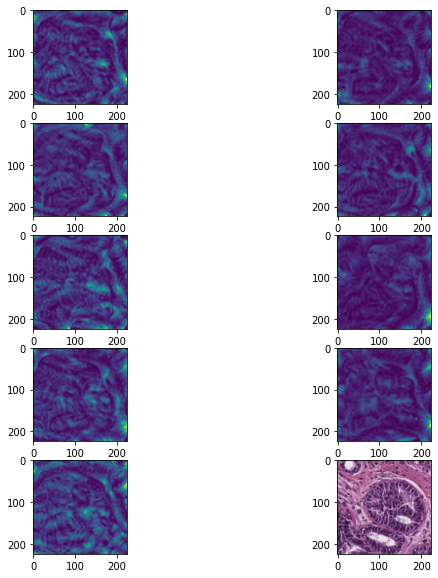

In [27]:
fig = plt.figure(figsize = (10,10))
for k in range(1,10):
    plt.subplot(5,2,k)
    lbl = labels[k]
    plt.imshow(maps[lbl][k])
    plt.subplot(5,2,k+1)
    plt.imshow(np.transpose(images[k], [1,2,0]))

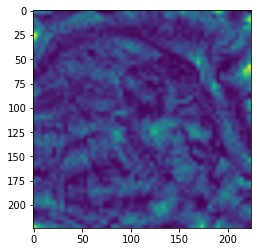

In [28]:
plt.imshow(maps[labels[19]][9])

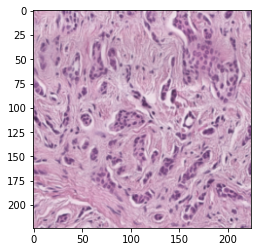

In [29]:
plt.imshow(np.transpose(images[0], [1,2,0]))